# Extract and plot data along a profile
The module `antarctic_plots.profile` provides convienent tools to extract data along a profile, and automatically create plots of the results. These plots can optionally include a map, a cross section of earth layers, and a profile of other datasets.

In [1]:
from antarctic_plots import profile, fetch

c:\Users\matthewt\AppData\Local\miniforge3\envs\antarctic_plots_dev\lib\site-packages\xarray\backends\cfgrib_.py:29: UserWarning: Failed to load cfgrib - most likely there is a problem accessing the ecCodes library. Try `import cfgrib` to get the full error message
  warnings.warn(


## Make a simple cross-section
define a start and end point for a profile, in EPSG:3031 projection. See {doc}`../tips` for a map with EPSG gridlines.

In [2]:
a = (-1200e3, -1400e3)
b = (1000e3, 1400e3)

sample bedmachine layers between these points, and plot the cross section

c:\Users\matthewt\AppData\Local\miniforge3\envs\antarctic_plots_dev\lib\site-packages\xarray\backends\plugins.py:64: RuntimeWarning: Engine 'cfgrib' loading failed:
Cannot find the ecCodes library
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)


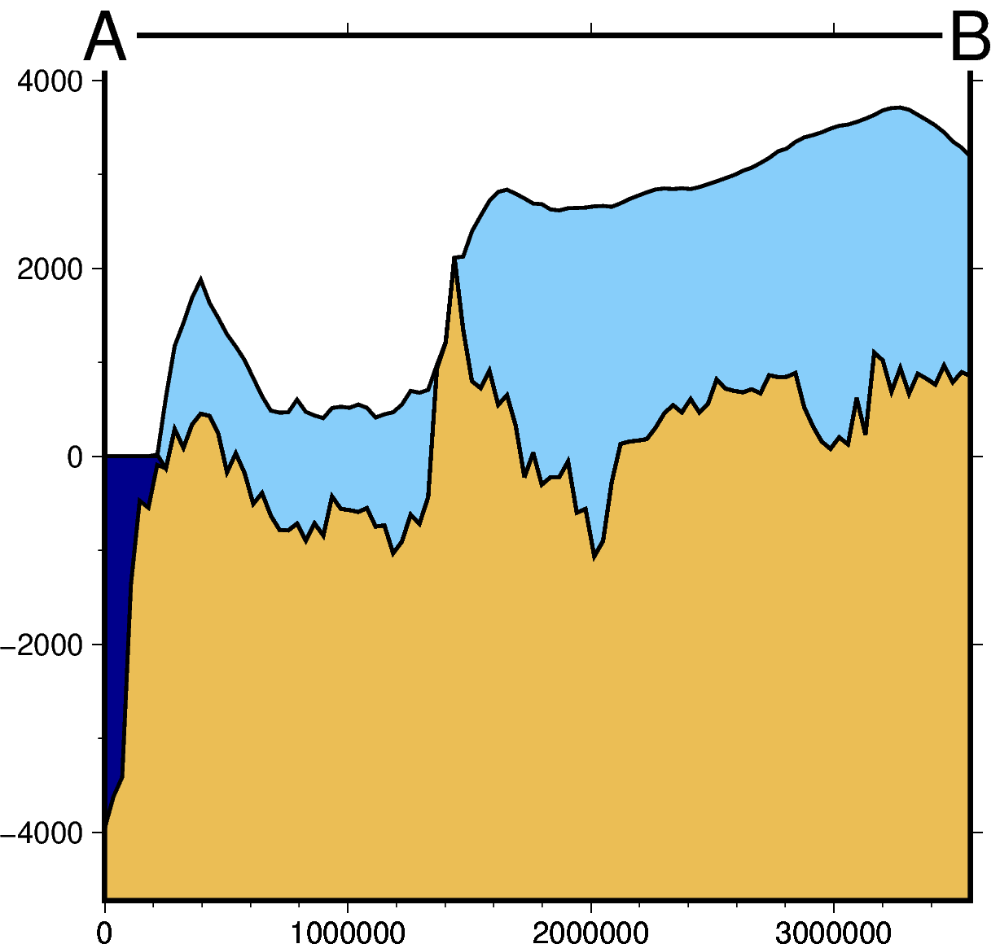

In [3]:
profile.plot_profile(
    method="points",
    start=a,
    stop=b,
)

Instead of using a line defined by 2 poitns, we can sample along a shapefile.Provide a file name, or load a already included shapefile with the function `fetch`.

Here is a curved path across the Ross Ice Shelf from Mulock Glacier to the ice front through Discovery Deep.

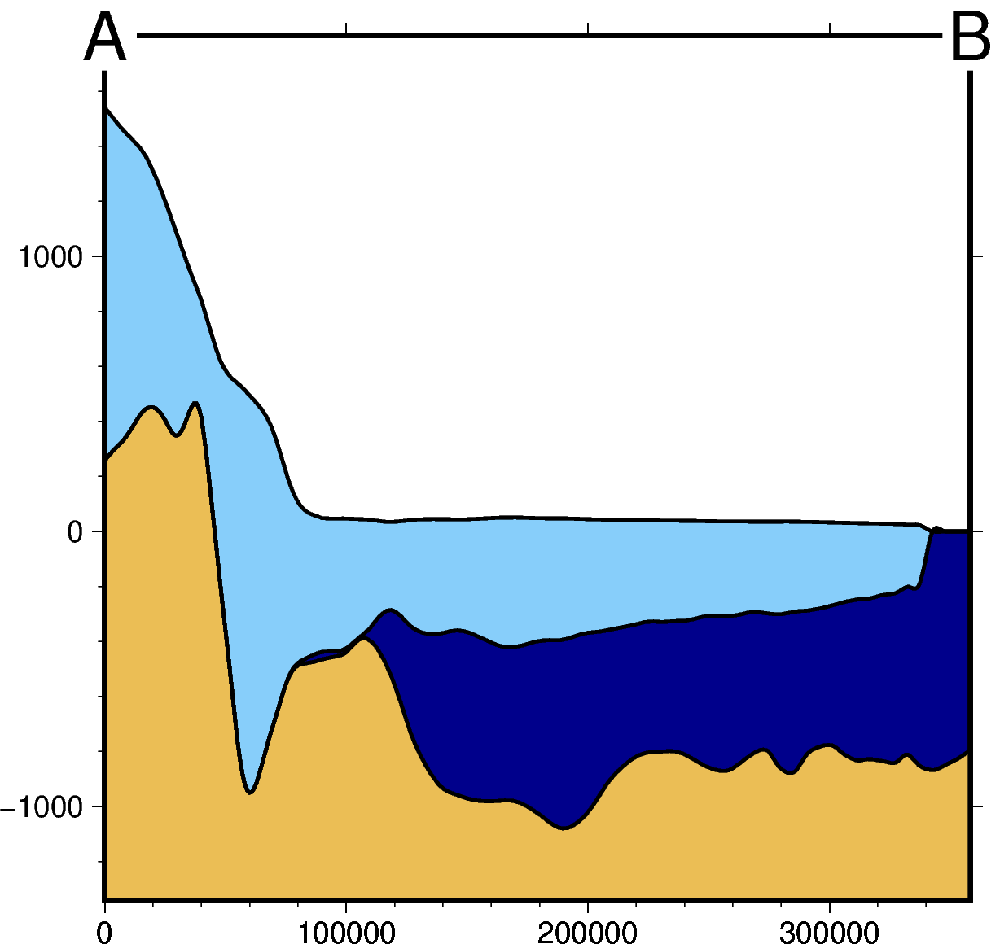

In [4]:
profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp("Disco_deep_transect"),
)

## Add a map
show the profile location by adding a map with a default background of satellite imagery

gmtset [WARNING]: Representation of font type not recognized. Using default.


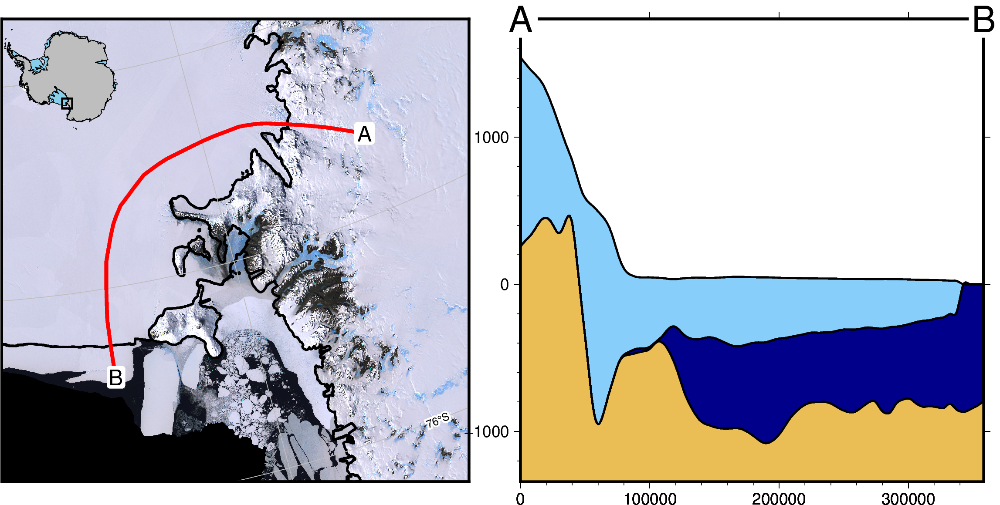

In [5]:
profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp("Disco_deep_transect"),
    add_map=True,
)

## Add a graph of data
Sample and plot additional datasets along the same profile with `data_dict`. By default this includes gravity and magnetics.

gmtset [WARNING]: Representation of font type not recognized. Using default.


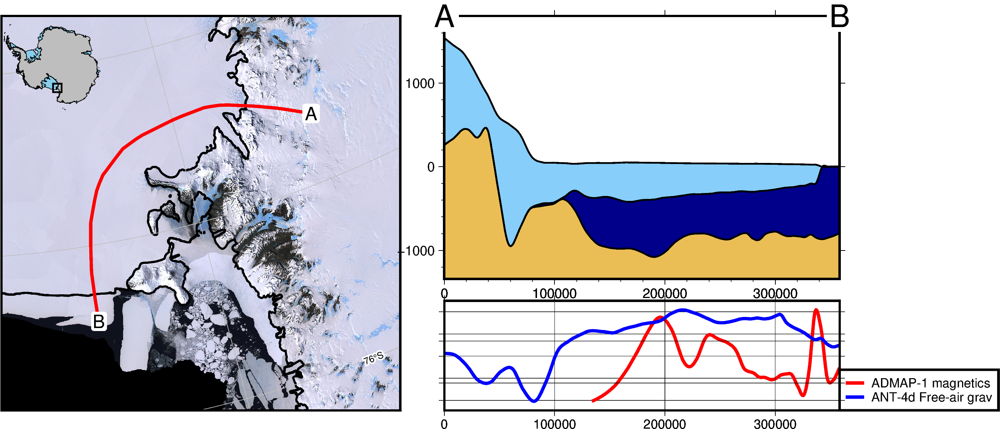

In [6]:
profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp("Disco_deep_transect"),
    add_map=True,
    data_dict="default",
    save=True,  # save the plot to use in README
    path="../cover_fig.png",
)

## Change profile length
clip the profile (either end) based on distance

gmtset [WARNING]: Representation of font type not recognized. Using default.


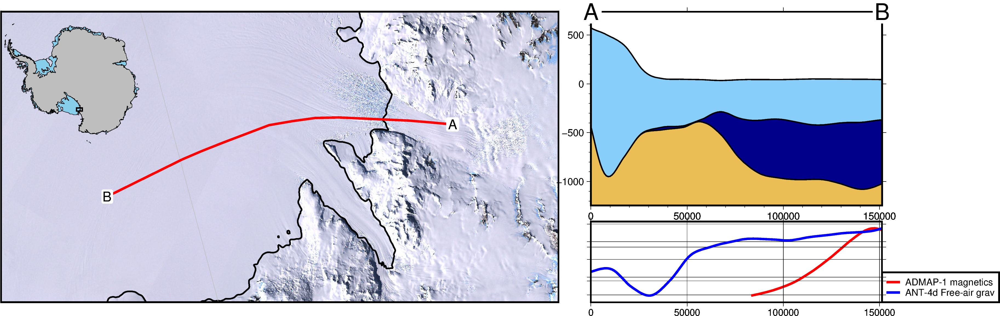

In [7]:
profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp("Disco_deep_transect"),
    data_dict="default",
    add_map=True,
    clip=True,
    min_dist=50e3,
    max_dist=200e3,
)

## Change sampling resolution
increase the resolution of the sampling. If using a profile defined by 2 points, use parameter "num", which defaults to 100 points along the line.

gmtset [WARNING]: Representation of font type not recognized. Using default.


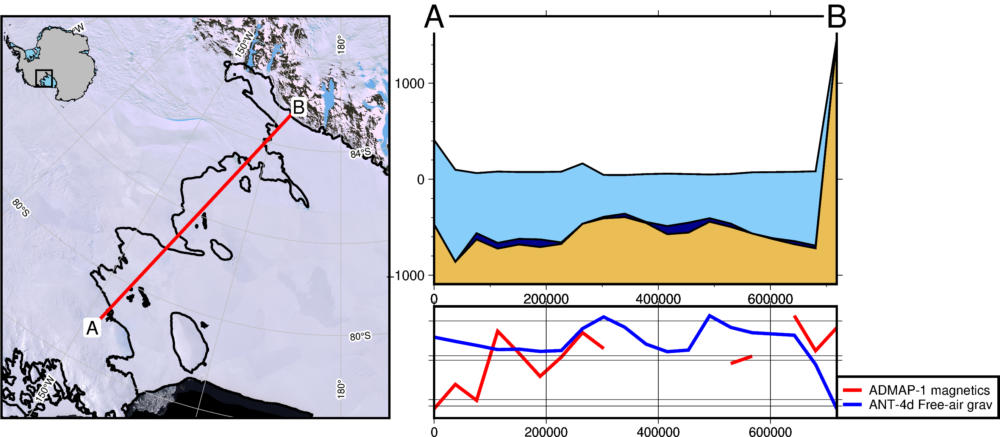

gmtset [WARNING]: Representation of font type not recognized. Using default.


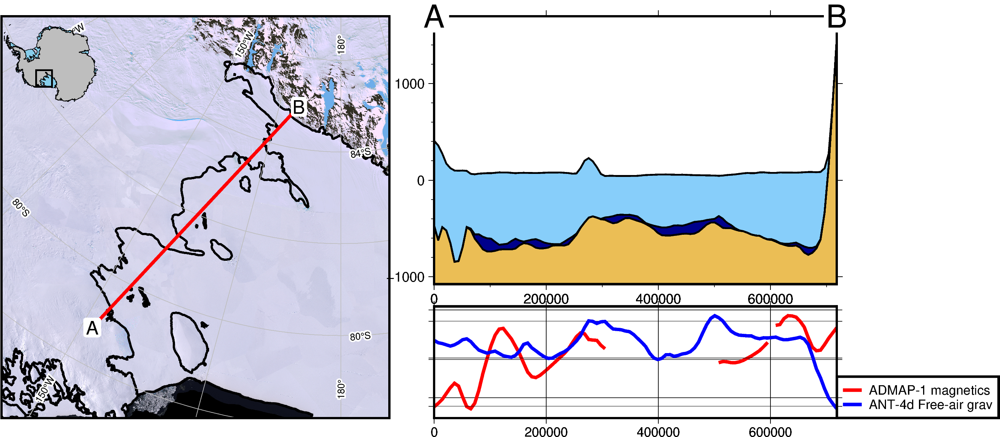

In [8]:
# define new profile endpoints
a = (-590e3, -1070e3)
b = (-100e3, -545e3)

profile.plot_profile(
    method="points",
    start=a,
    stop=b,
    num=20,
    data_dict="default",
    add_map=True,
)

profile.plot_profile(
    method="points",
    start=a,
    stop=b,
    num=100,
    data_dict="default",
    add_map=True,
)

Instead, if using a shapefile, change the sampling resolutions with shp_num_points.

gmtset [WARNING]: Representation of font type not recognized. Using default.


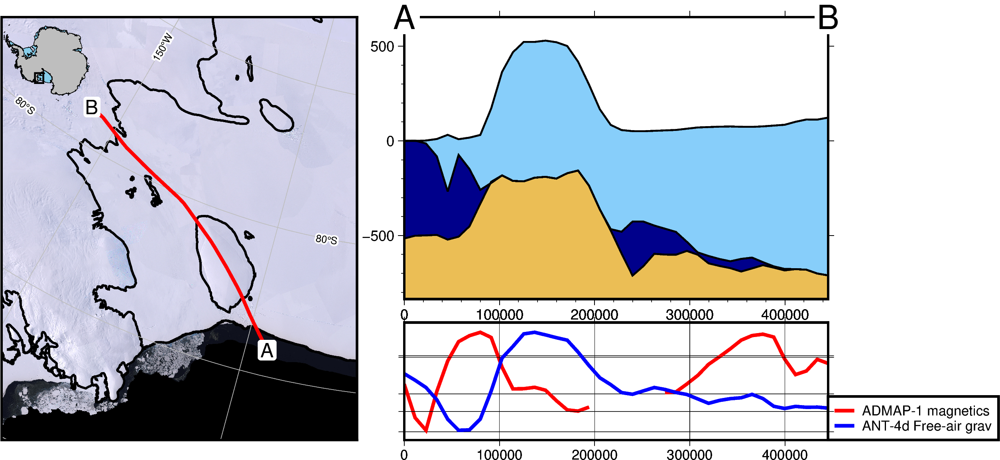

gmtset [WARNING]: Representation of font type not recognized. Using default.


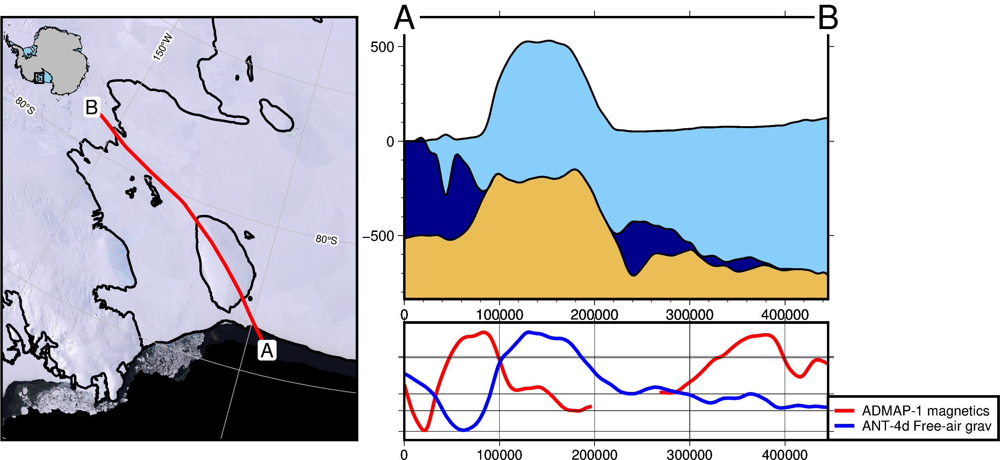

In [9]:
profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp(
        "Roosevelt_Island",
    ),
    shp_num_points=40,
    data_dict="default",
    add_map=True,
)

profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp(
        "Roosevelt_Island",
    ),
    shp_num_points=200,
    data_dict="default",
    add_map=True,
)

## Alter map properies

Use `map_background` to change the grid shown on the map. Here, instead of the default imagery, we will show the surface topography from bedmachine.

gmtset [WARNING]: Representation of font type not recognized. Using default.


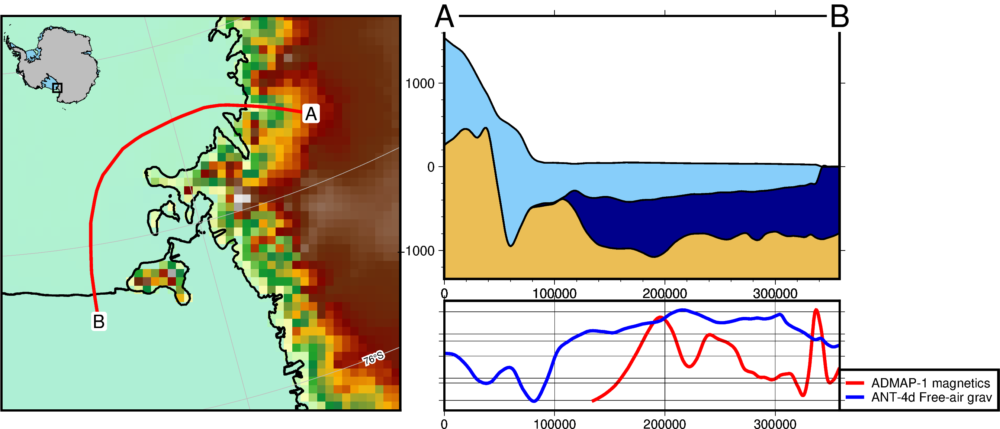

In [10]:
profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp("Disco_deep_transect"),
    data_dict="default",
    add_map=True,
    map_background=fetch.bedmachine("surface"),
)

Use 'map_cmap` to change the maps colorscale

gmtset [WARNING]: Representation of font type not recognized. Using default.


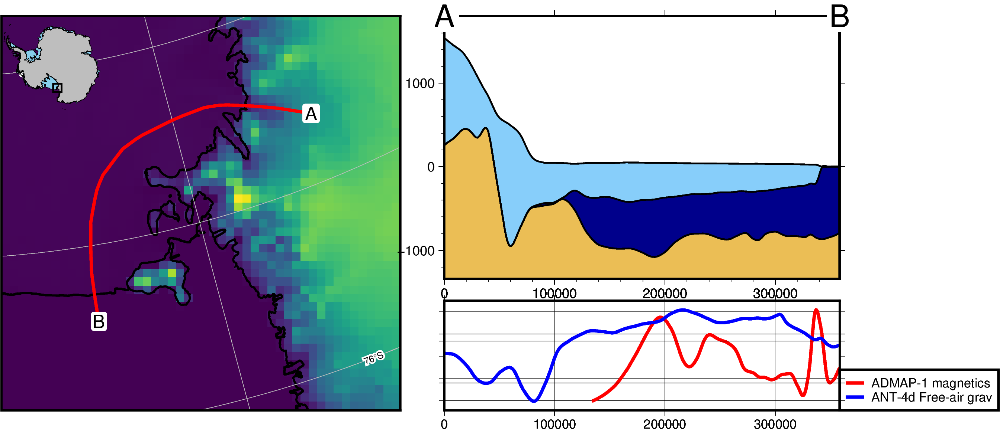

In [18]:
profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp("Disco_deep_transect"),
    data_dict="default",
    add_map=True,
    map_background=fetch.bedmachine("surface"),
    map_cmap="viridis",
    # save to use in the docs
    save=True,
    path="outputs/profile_walkthrough.png",
)

Use `map_buffer` to change the level of zoom on the map. This is a percentage of total line distance, which defaults to 0.3 (130%) of profile length. So if the profile is 100km long, the default map will be 130km along the longest axis.

gmtset [WARNING]: Representation of font type not recognized. Using default.


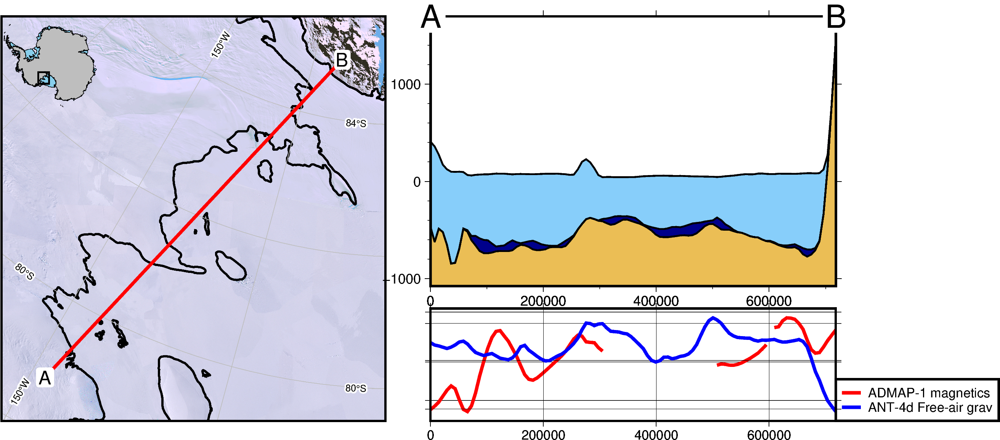

gmtset [WARNING]: Representation of font type not recognized. Using default.


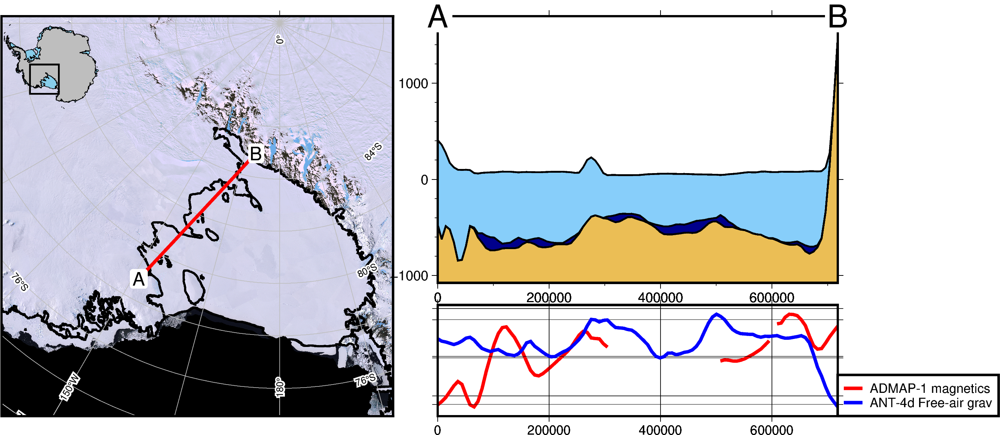

In [12]:
profile.plot_profile(
    method="points",
    start=a,
    stop=b,
    data_dict="default",
    add_map=True,
    map_buffer=0.1,
)

profile.plot_profile(
    method="points",
    start=a,
    stop=b,
    data_dict="default",
    add_map=True,
    map_buffer=0.8,
)

## Alter Cross-section properties

Use `layer_buffer` to alter the amount of whitespace above and below the cross-section layers, this defaults to 0.1 (10% of data spread added above/below)

gmtset [WARNING]: Representation of font type not recognized. Using default.


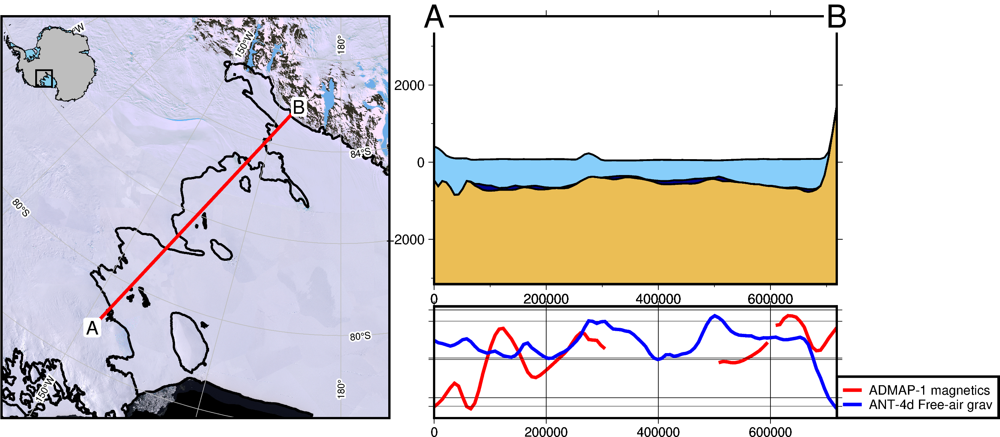

In [13]:
profile.plot_profile(
    method="points",
    start=a,
    stop=b,
    data_dict="default",
    add_map=True,
    layer_buffer=1.0,
)

## Alter Cross-section properties

Use `data_buffer` to alter the whitespace above and below data graph, defaults to 0.1 (10% of data spread added above/below) 

gmtset [WARNING]: Representation of font type not recognized. Using default.


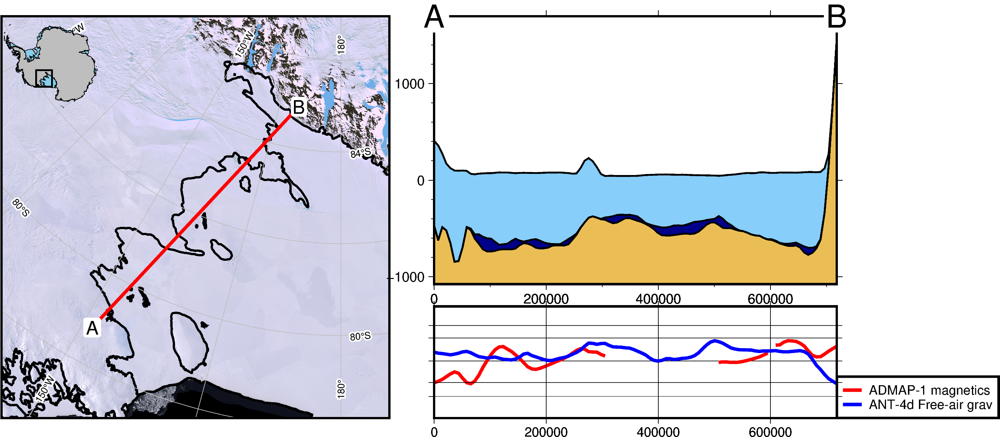

In [14]:
profile.plot_profile(
    method="points", start=a, stop=b, data_dict="default", add_map=True, data_buffer=0.8
)

## Custom layers, datasets, and colors
The input for both the data and the layers are nested dictionaries, where each dictionary entry contains keys: 'name', 'grid', and 'color'.

Use the function, `profile.make_data_dict()` to help create these dictionaries.
It takes 3 inputs, which are:
 * a list of names
 * a list of grids
    either geotiff/netcdf file names or xarray.DataArrays
 *  a list of colors.

For example, if you have a netcdf file 'ice_velocity.nc' which you want to plot as orange, you can make that into a dictionary with:
    `profile.make_data_dict(['ice velocity'], ['ice_velocity.nc'], ['orange'])`

Optionally, you can use `Pooch.fetch` to help download and store dataset from urls, and easily load them.

See the functions in the module `antarctic_plots.fetch` for examples and feel free to make a PR and add your datasets there.

``` WARNING - the DeepBedMap file is relatively large (0.5 Gb) and may take some time to download```

gmtset [WARNING]: Representation of font type not recognized. Using default.


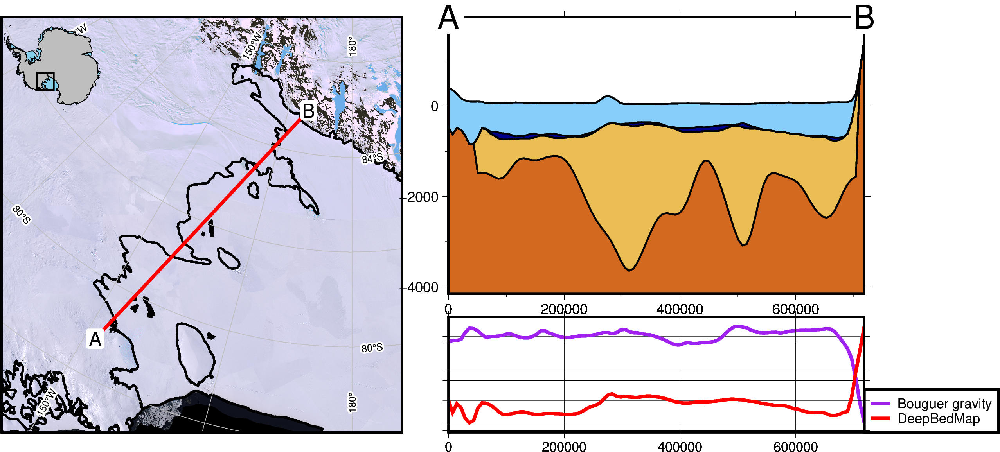

In [15]:
# note, these datafile can be plotted at higher resolution by adding parameter 'spacing' to the 'fetch' function:
# fetch.gravity('BA', spacing=1e3) will use a 1km version of the Bouguer gravity anomaly.
data_dict = profile.make_data_dict(
    ["Bouguer gravity", "DeepBedMap"],
    [fetch.gravity("BA"), fetch.deepbedmap()],
    ["purple", "red"],
)

# get default bedmachine layers
layers_dict = profile.default_layers()

# add dictionary entry of extra layer 'basement'
layers_dict["basement"] = {}
layers_dict["basement"]["name"] = "basement"
layers_dict["basement"]["grid"] = fetch.basement()
layers_dict["basement"]["color"] = "chocolate"

a = (-590e3, -1070e3)
b = (-100e3, -545e3)

profile.plot_profile(
    "points",
    start=a,
    stop=b,
    add_map=True,
    data_dict=data_dict,
    layers_dict=layers_dict,
)

Control wheather to fill gaps in the cross-section layers. Note that the additional layer 'basement', doesn't extend past the groundingline. By default, NaN's in any layer are set equal
to the layer above, causing the vertical line at ~100km.

gmtset [WARNING]: Representation of font type not recognized. Using default.


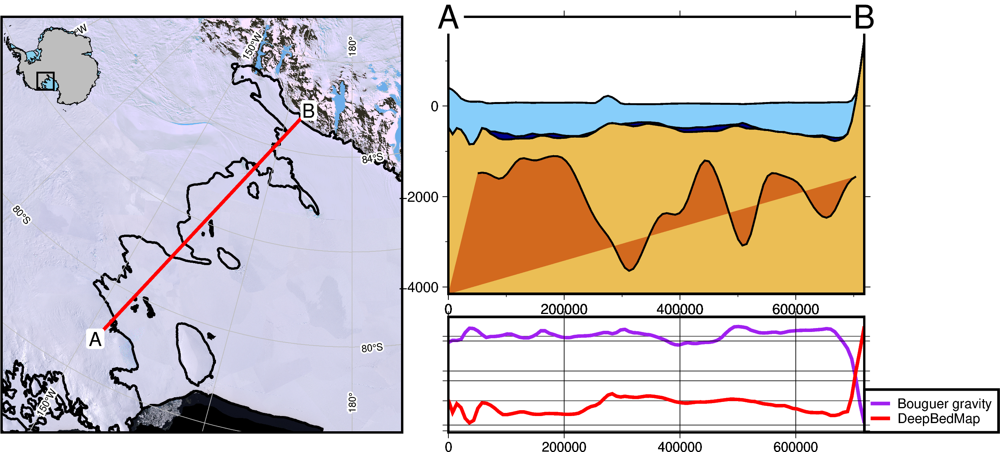

In [17]:
profile.plot_profile(
    "points",
    start=a,
    stop=b,
    add_map=True,
    data_dict=data_dict,
    layers_dict=layers_dict,
    fillnans=False,
)